In [ ]:
import os
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split

IMAGE_PATH = "/content/drive/MyDrive/DGMD E-14/Project/MARSDATA"
IMG_HEIGHT, IMG_WIDTH = 128, 128

def load_images(image_path):
    images = []
    filenames = []
    if not os.path.exists(image_path):
        print(f"Error: Path '{image_path}' does not exist.")
        return images, filenames

    for file in os.listdir(image_path):
        if file.lower().endswith((".jpg", ".jpeg", ".png")):
            img_path = os.path.join(image_path, file)
            try:
                img = cv2.imread(img_path)
                if img is not None:
                    img_resized = cv2.resize(img, (IMG_HEIGHT, IMG_WIDTH))
                    images.append(img_resized)
                    filenames.append(file)
                else:
                    print(f"Warning: Failed to load {img_path}")
            except Exception as e:
                print(f"Error loading {img_path}: {e}")

    if not images:
        print("Warning: No images loaded.")
    else:
        print(f"Successfully loaded {len(images)} images.")
    return np.array(images), filenames

images, filenames = load_images(IMAGE_PATH)
print(f"Loaded {len(images)} images: {filenames[:5]}")

def generate_pseudo_labels(images, n_clusters=2):
    features = images.reshape(len(images), -1)
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(features)
    return labels

def create_model():
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)),
        MaxPooling2D((2, 2)),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPooling2D((2, 2)),
        Flatten(),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

def main():
    images, filenames = load_images(IMAGE_PATH)
    print(f"Loaded {len(images)} images.")

    labels = generate_pseudo_labels(images, n_clusters=2)

    X_train, X_test, y_train, y_test = train_test_split(images / 255.0, labels, test_size=0.2, random_state=42)

    model = create_model()
    model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))

    loss, accuracy = model.evaluate(X_test, y_test)
    print(f"Test Accuracy: {accuracy:.2f}")

    model.save("mars_obstacle_model.h5")
    print("Model saved as mars_obstacle_model.h5")

if __name__ == "__main__":
    main()

Successfully loaded 34 images.
Loaded 34 images: ['NLA_400071081EDR_F0040000NCAM00408M1.JPG', 'NLA_399365236EDR_F0030100NCAM00403M1.JPG', 'NLA_400071025EDR_F0040000NCAM00408M1.JPG', 'NLA_399365272EDR_F0030100NCAM00403M1.JPG', 'NLA_399627538EDR_F0030372NCAM00407M1.JPG']
Successfully loaded 34 images.
Loaded 34 images.


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step - accuracy: 0.5926 - loss: 0.6774 - val_accuracy: 0.8571 - val_loss: 0.7821
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - accuracy: 0.7407 - loss: 2.1747 - val_accuracy: 0.8571 - val_loss: 0.5715
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - accuracy: 0.7407 - loss: 1.4038 - val_accuracy: 0.8571 - val_loss: 0.2754
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - accuracy: 0.7407 - loss: 0.7384 - val_accuracy: 0.2857 - val_loss: 0.7227
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - accuracy: 0.6296 - loss: 0.9191 - val_accuracy: 1.0000 - val_loss: 0.5515
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.5185 - loss: 0.8795 - val_accuracy: 0.8571 - val_loss: 0.3537
Epoch 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.7778 - loss: 0.4569 - val_accuracy: 0.8571 - val_loss: 0.2839
Epoch 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.7778 - loss: 0.4072 - val_accuracy: 0.8571 - val_loss: 0.2746
Epo

Test Accuracy: 1.00
Model saved as mars_obstacle_model.h5


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Loaded 34 images.
Processing image 1/34: NLA_400071081EDR_F0040000NCAM00408M1.JPG
Path found!


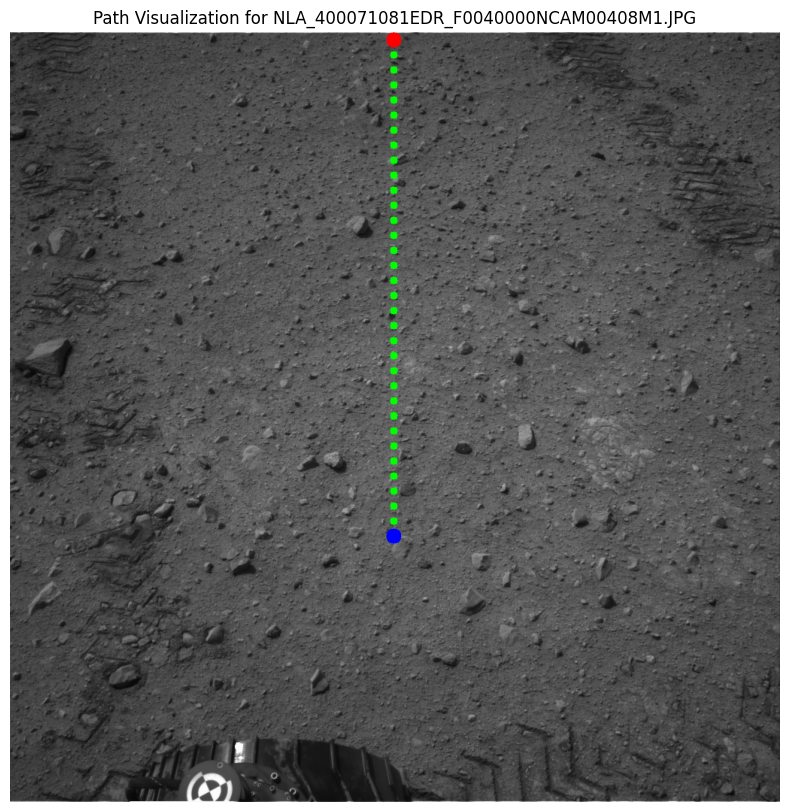

Processing image 2/34: NLA_399365236EDR_F0030100NCAM00403M1.JPG
Path found!


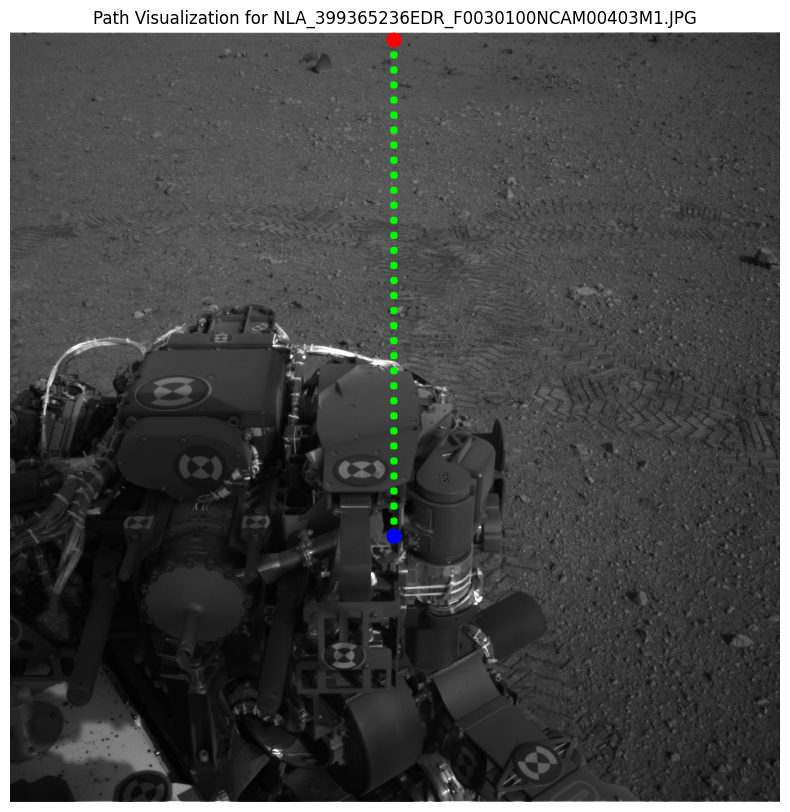

Processing image 3/34: NLA_400071025EDR_F0040000NCAM00408M1.JPG
Path found!


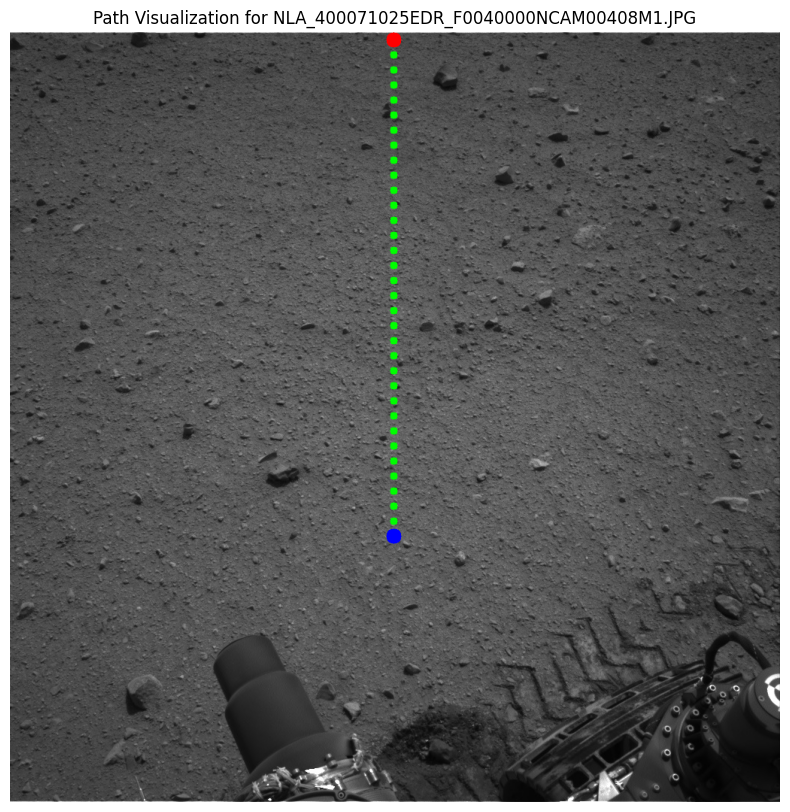

Processing image 4/34: NLA_399365272EDR_F0030100NCAM00403M1.JPG
Path found!


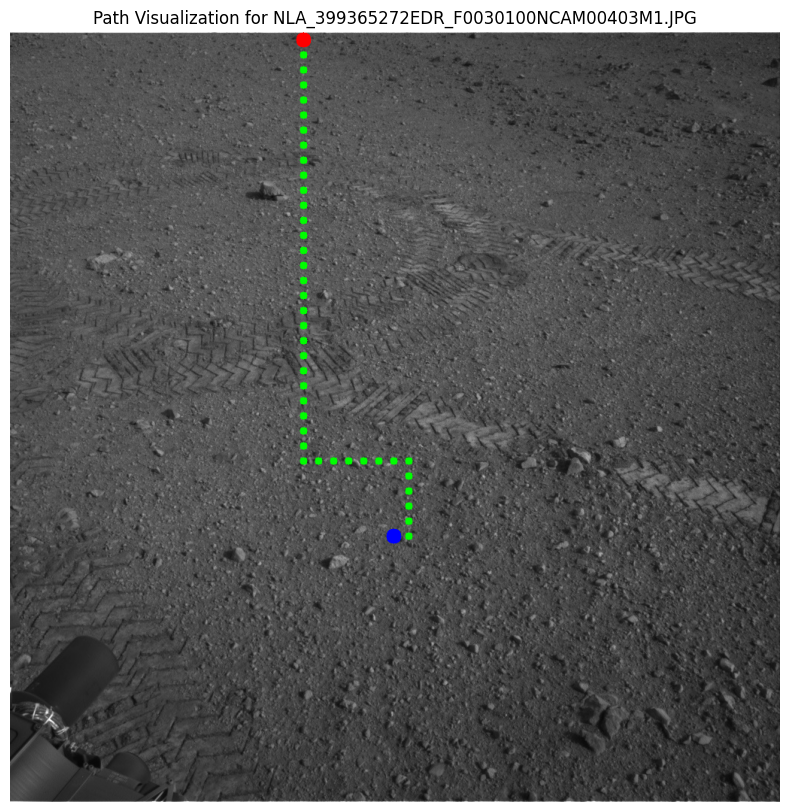

Processing image 5/34: NLA_399627538EDR_F0030372NCAM00407M1.JPG
Path found!


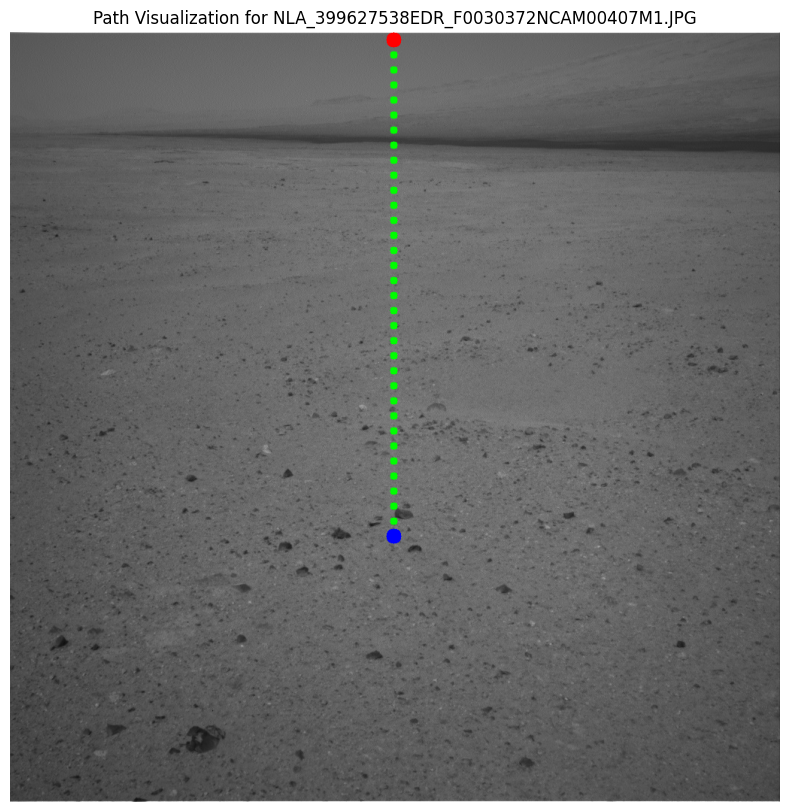

Processing image 6/34: NLA_399627567EDR_F0030372NCAM00407M1.JPG
Path found!


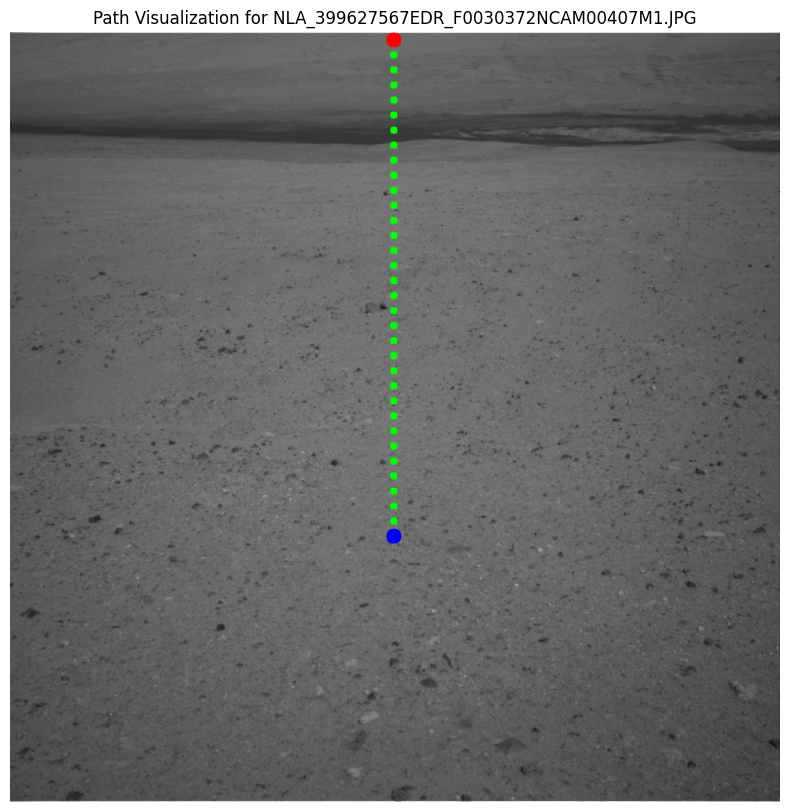

Processing image 7/34: NLA_398919819EDR_F0030078NCAM00301M1.JPG
Path found!


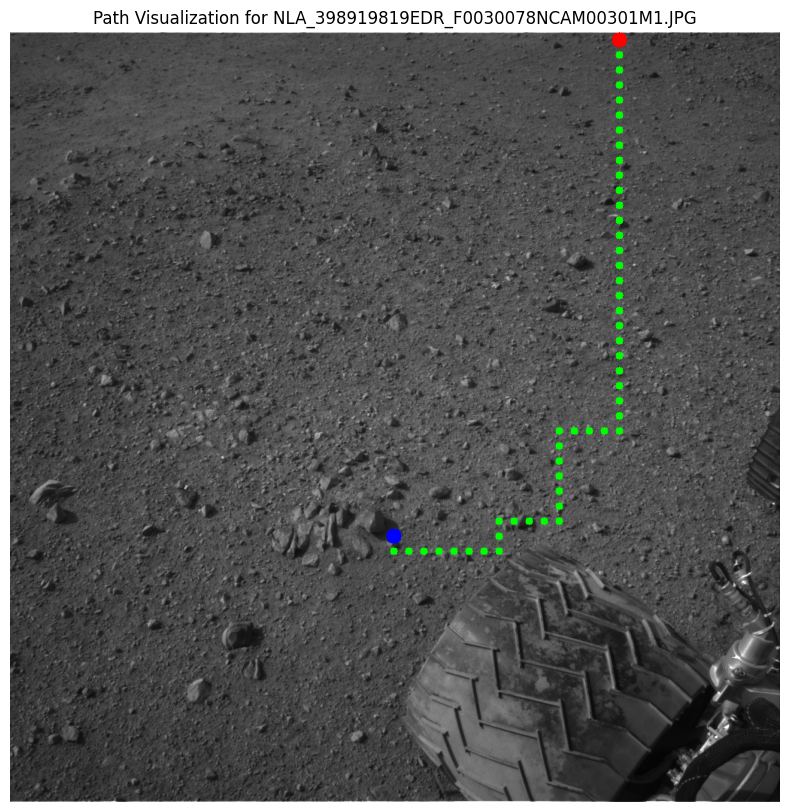

Processing image 8/34: NLA_398919692EDR_F0030078NCAM00301M1.JPG
No path found!
No valid path found.

Processing image 9/34: NLA_401936950EDR_F0042956NCAM00435M1.JPG
Path found!


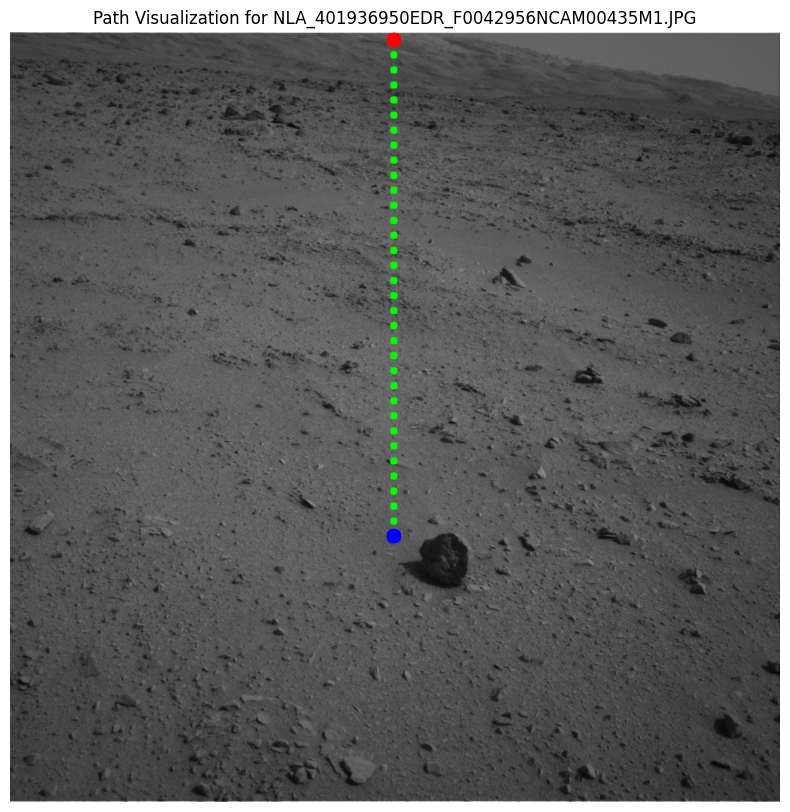

Processing image 10/34: NLA_399622593EDR_F0030350NCAM00404M1.JPG
Path found!


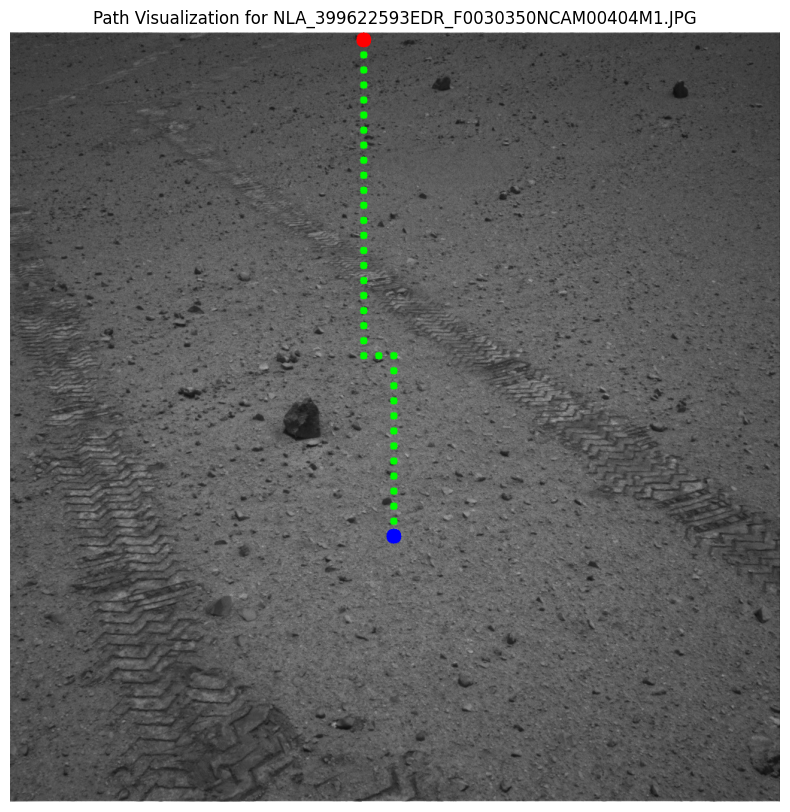

Processing image 11/34: NLA_399365300EDR_F0030100NCAM00403M1.JPG
No path found!
No valid path found.

Processing image 12/34: NLA_398920017EDR_F0030078NCAM00303M1.JPG
Path found!


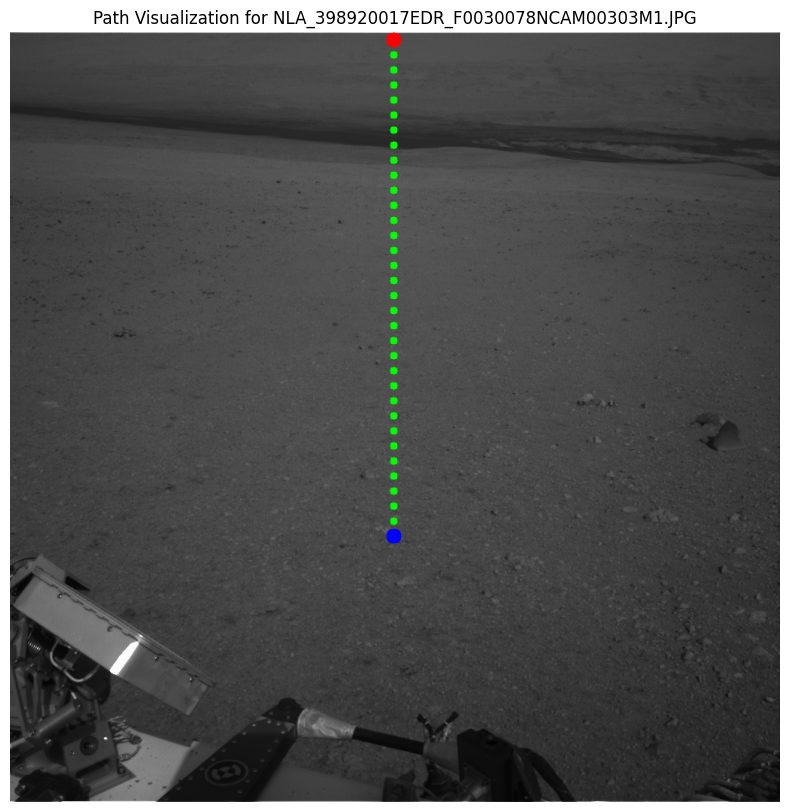

Processing image 13/34: NLA_401751359EDR_F0042100NCAM00307M1.JPG
Path found!


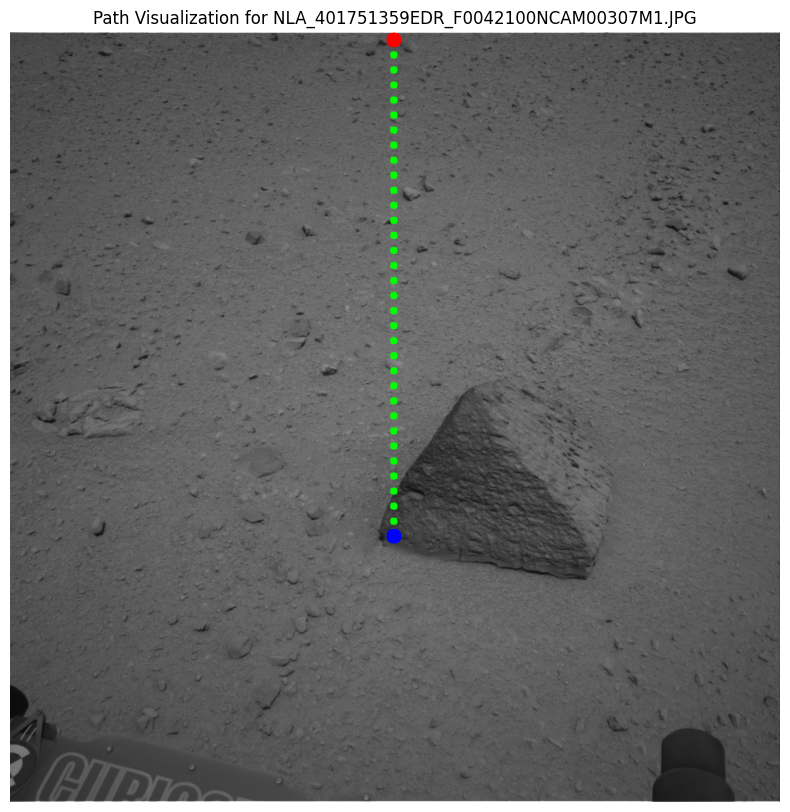

Processing image 14/34: NLA_398919728EDR_F0030078NCAM00301M1.JPG
Path found!


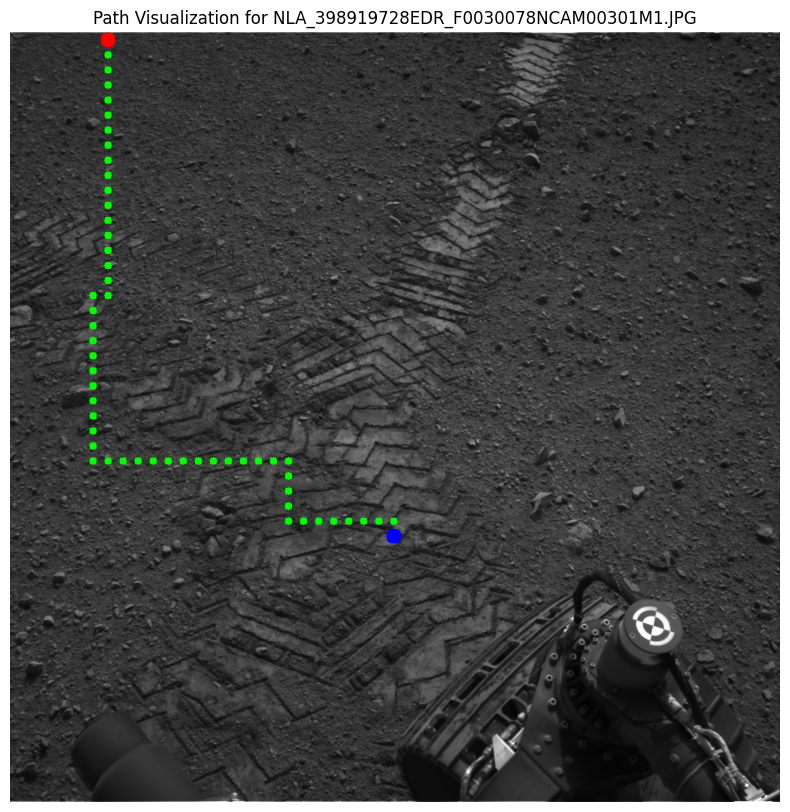

Processing image 15/34: NLA_399621461EDR_F0030308NCAM00404M1.JPG
Path found!


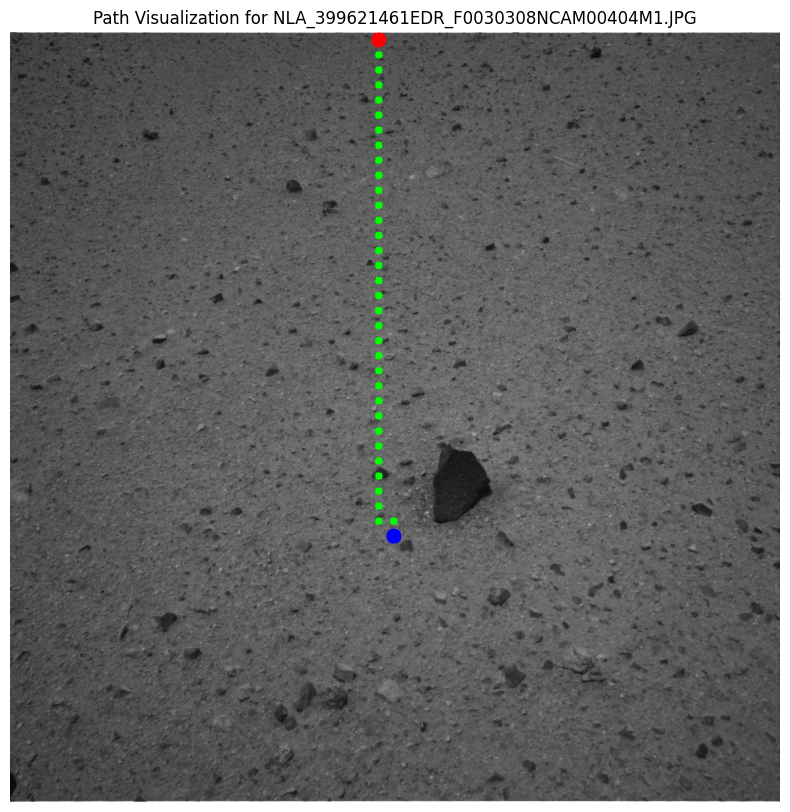

Processing image 16/34: NLA_400066615EDR_F0030872NCAM00302M1.JPG
Path found!


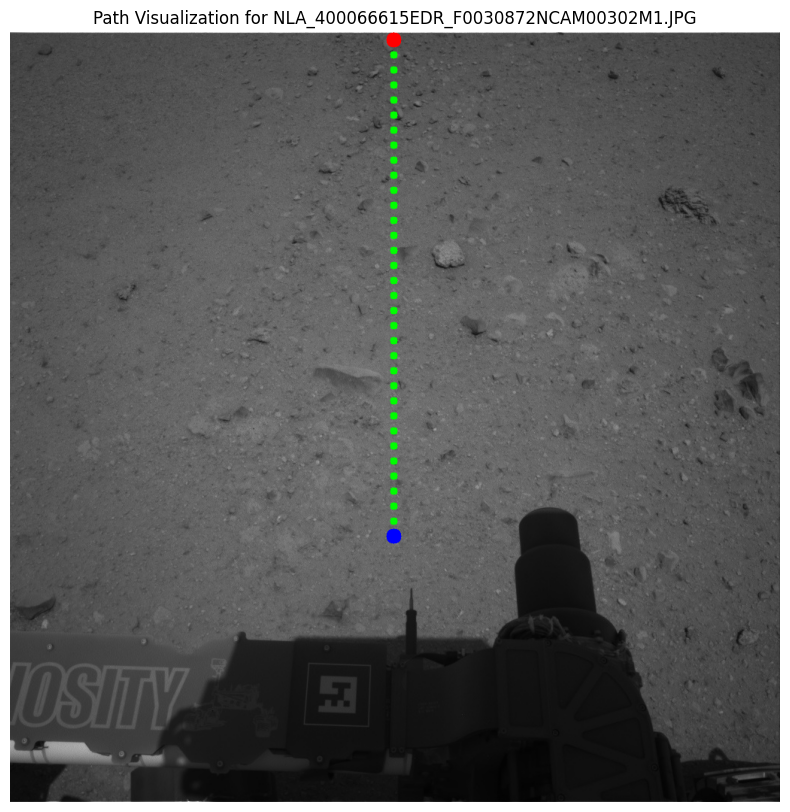

Processing image 17/34: NLA_399365176EDR_F0030100NCAM00305M1.JPG
Path found!


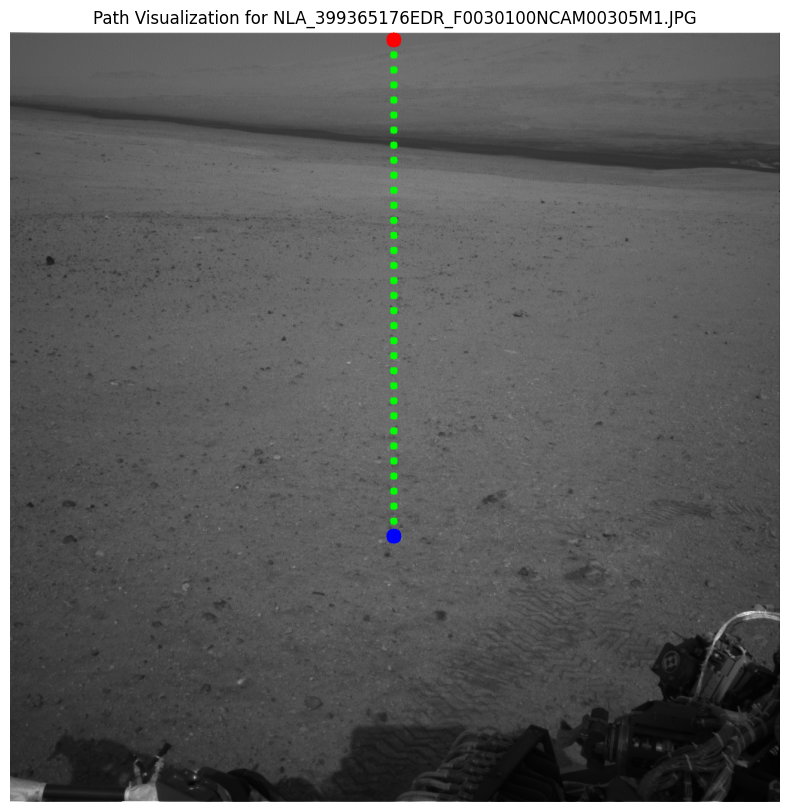

Processing image 18/34: NLA_399365204EDR_F0030100NCAM00305M1.JPG
Path found!


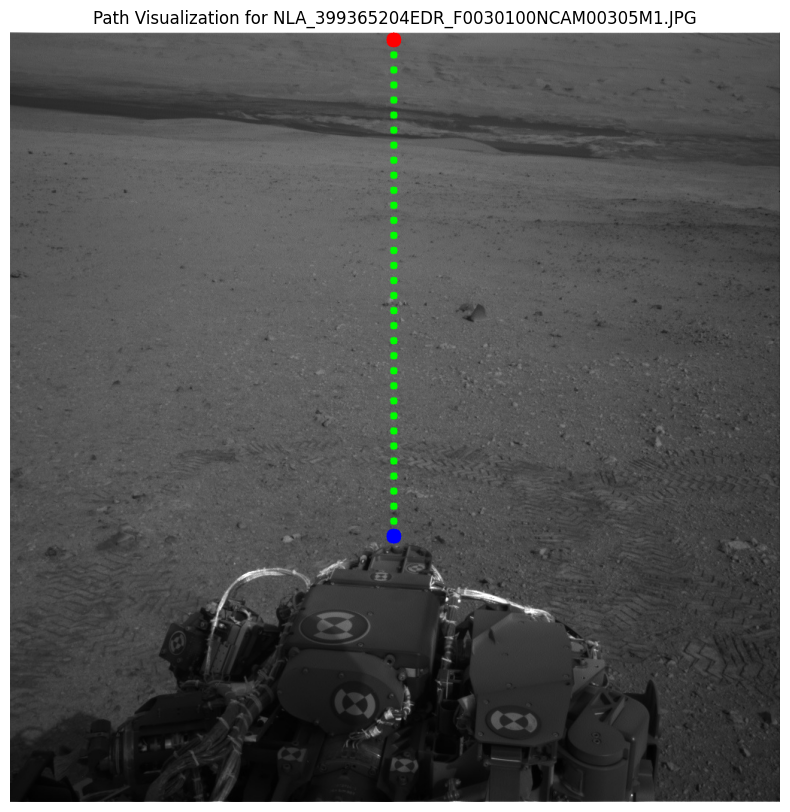

Processing image 19/34: NLA_398919642EDR_F0030078NCAM00300M1.JPG
Path found!


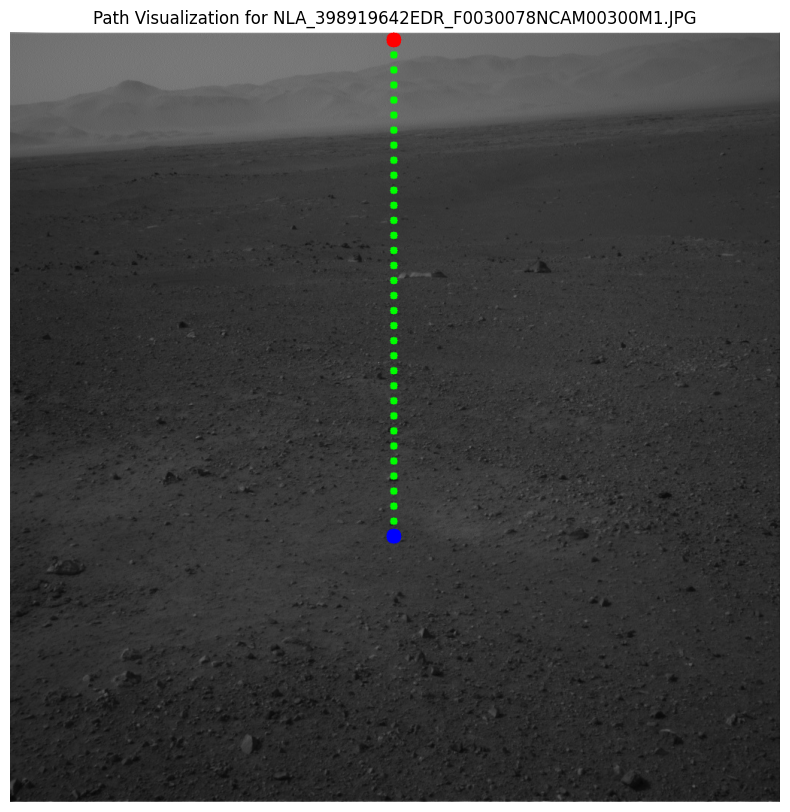

Processing image 20/34: NLA_398919572EDR_F0030078NCAM00300M1.JPG
Path found!


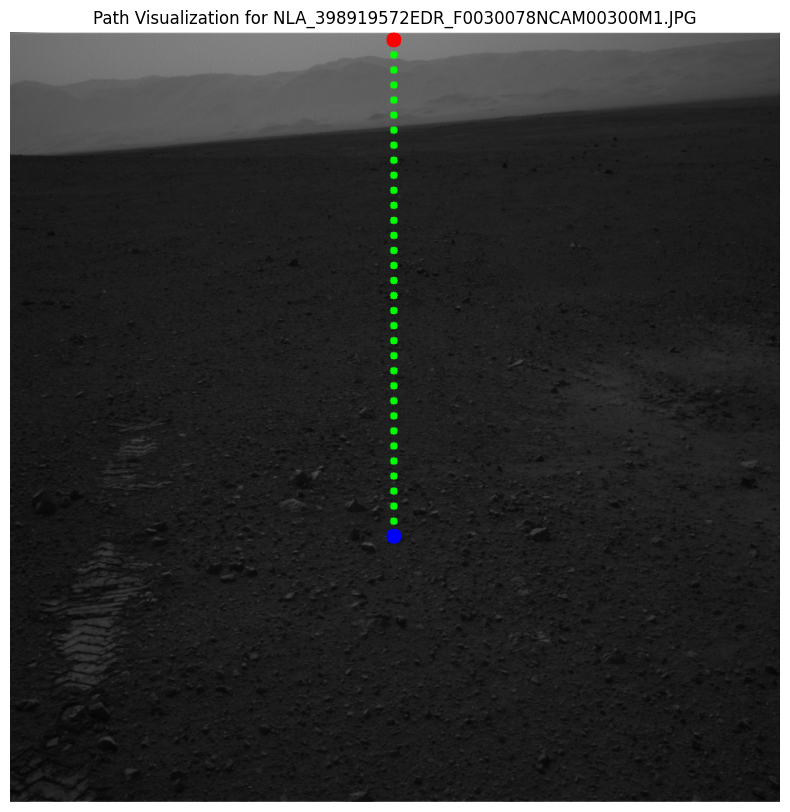

Processing image 21/34: NLA_399449733EDR_F0030106NCAM00411M1.JPG
Path found!


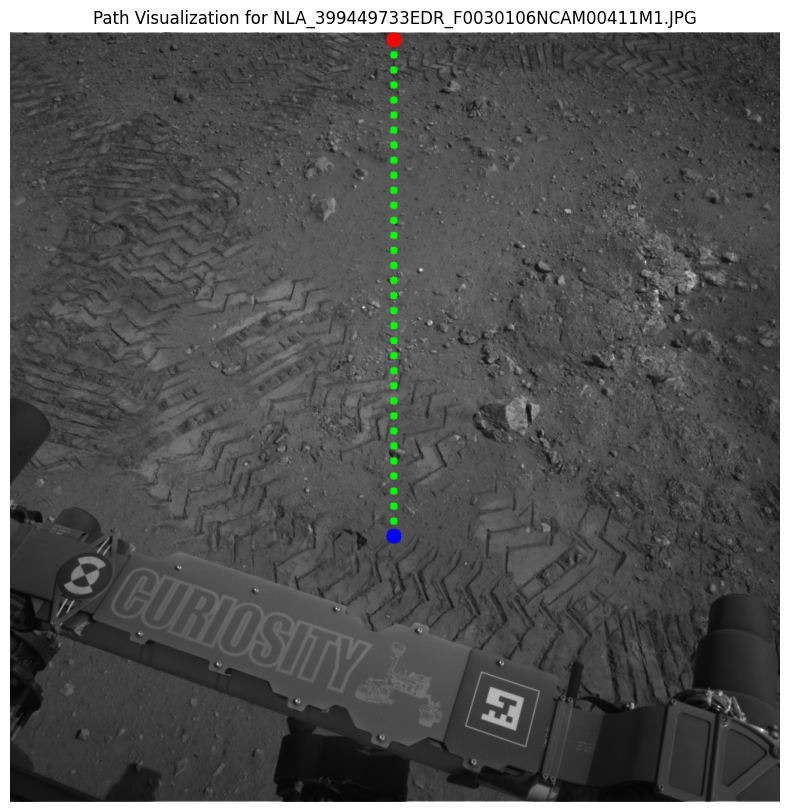

Processing image 22/34: NLA_398919855EDR_F0030078NCAM00303M1.JPG
Path found!


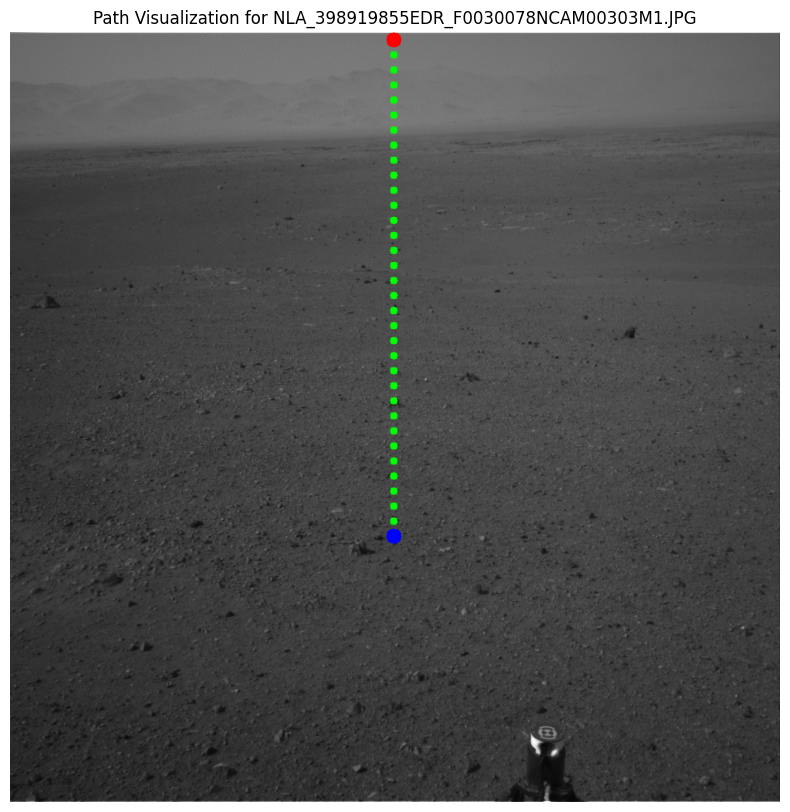

Processing image 23/34: NLA_400071053EDR_F0040000NCAM00408M1.JPG
Path found!


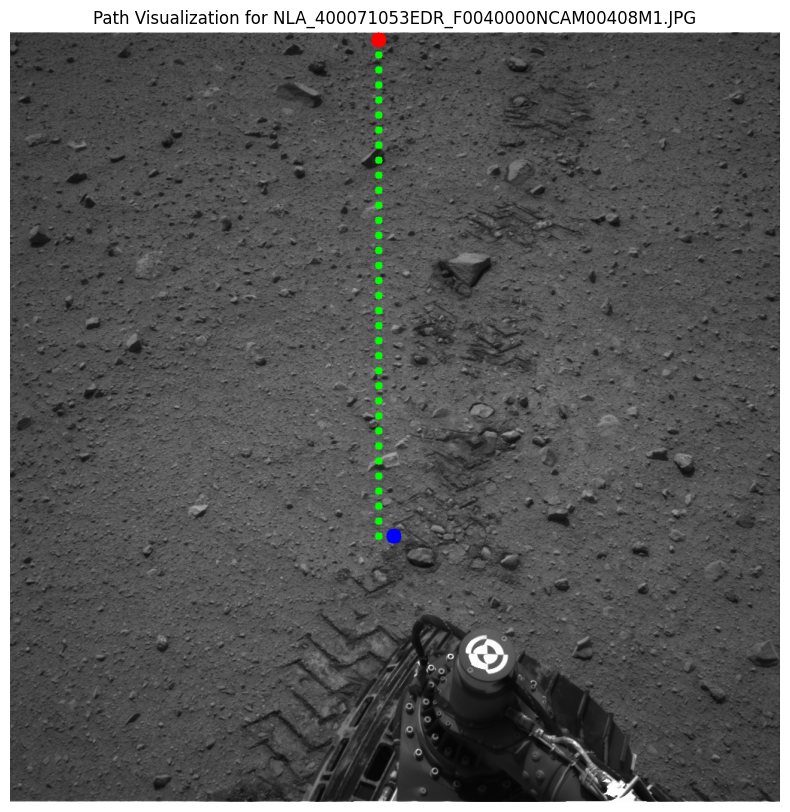

Processing image 24/34: NLA_399627595EDR_F0030372NCAM00407M1.JPG
Path found!


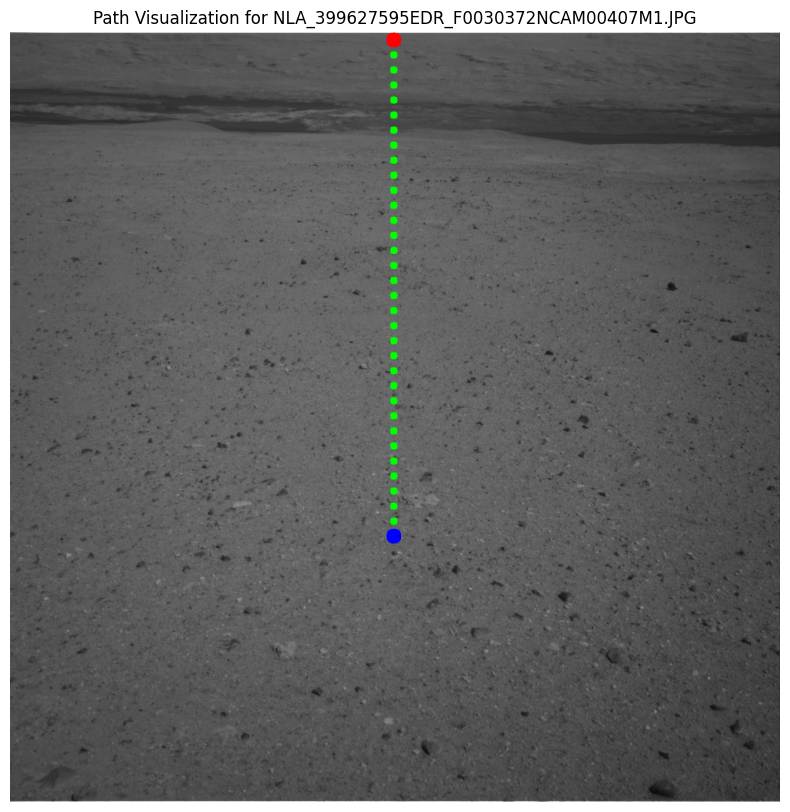

Processing image 25/34: NLA_401848369EDR_F0042778NCAM00409M1.JPG
Path found!


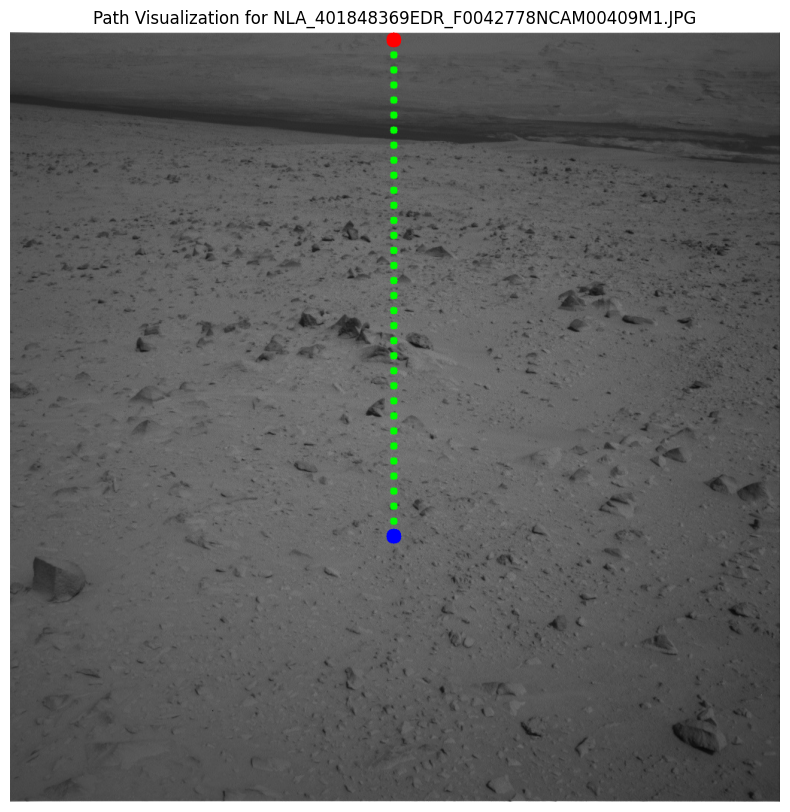

Processing image 26/34: NLA_398919983EDR_F0030078NCAM00303M1.JPG
Path found!


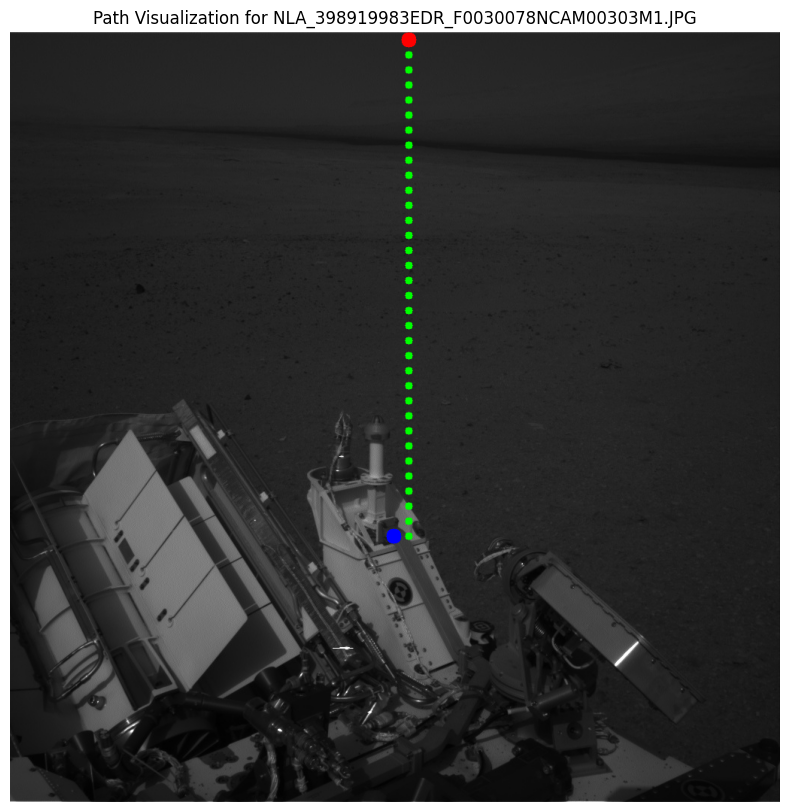

Processing image 27/34: NLA_398919784EDR_F0030078NCAM00301M1.JPG
Path found!


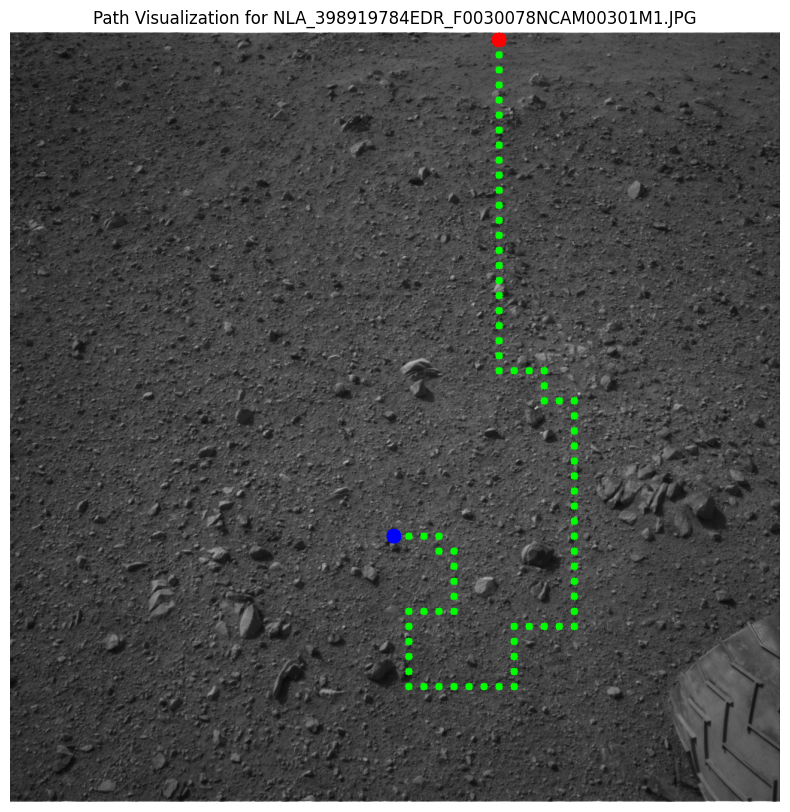

Processing image 28/34: NLA_401755662EDR_F0042274NCAM00307M1.JPG
Path found!


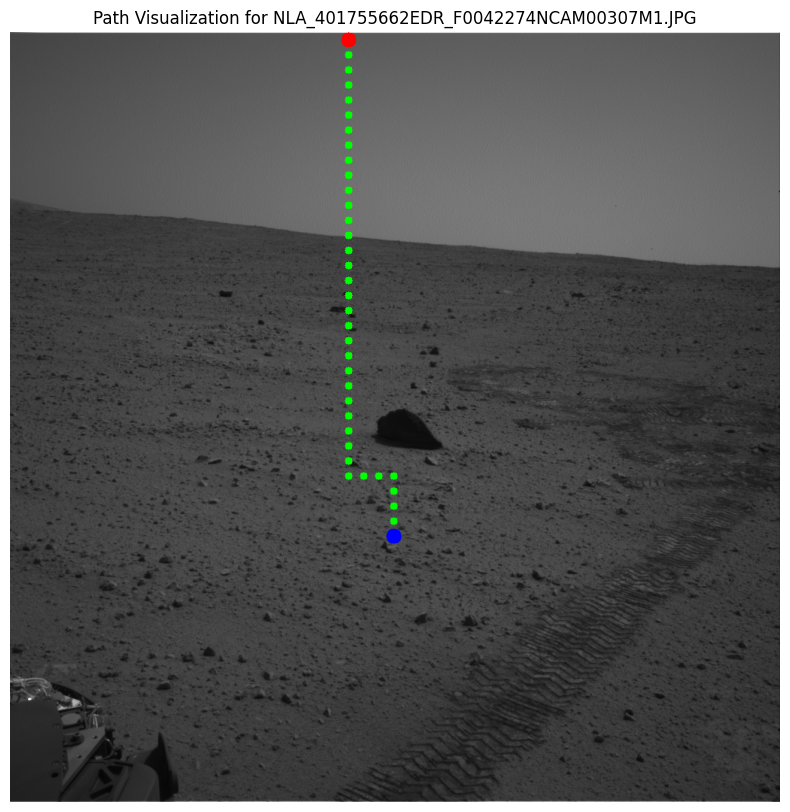

Processing image 29/34: NLA_400071109EDR_F0040000NCAM00408M1.JPG
Path found!


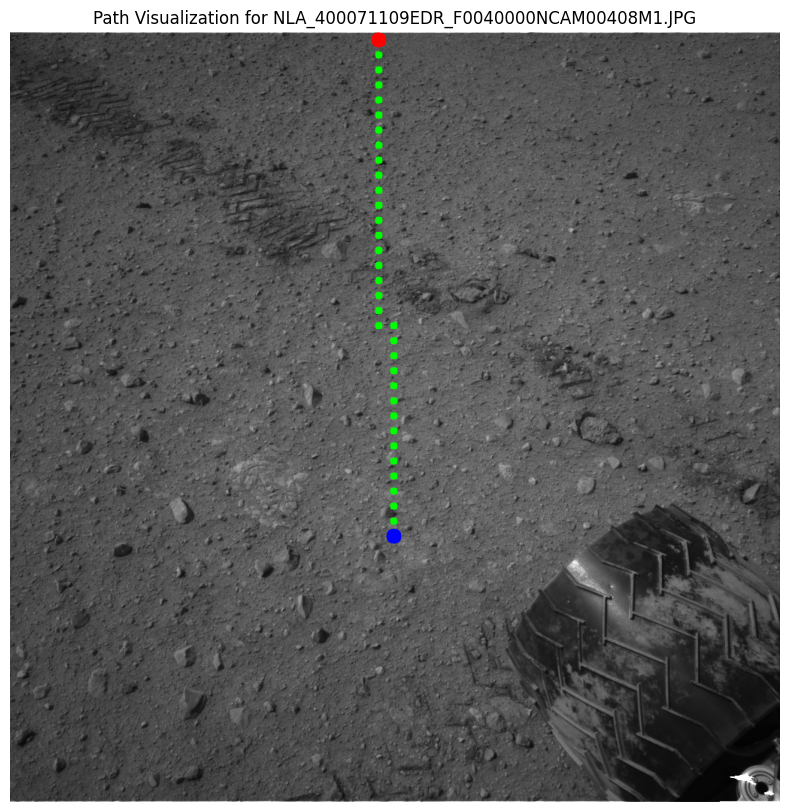

Processing image 30/34: NLA_401317063EDR_F0042002NCAM00431M1.JPG
Path found!


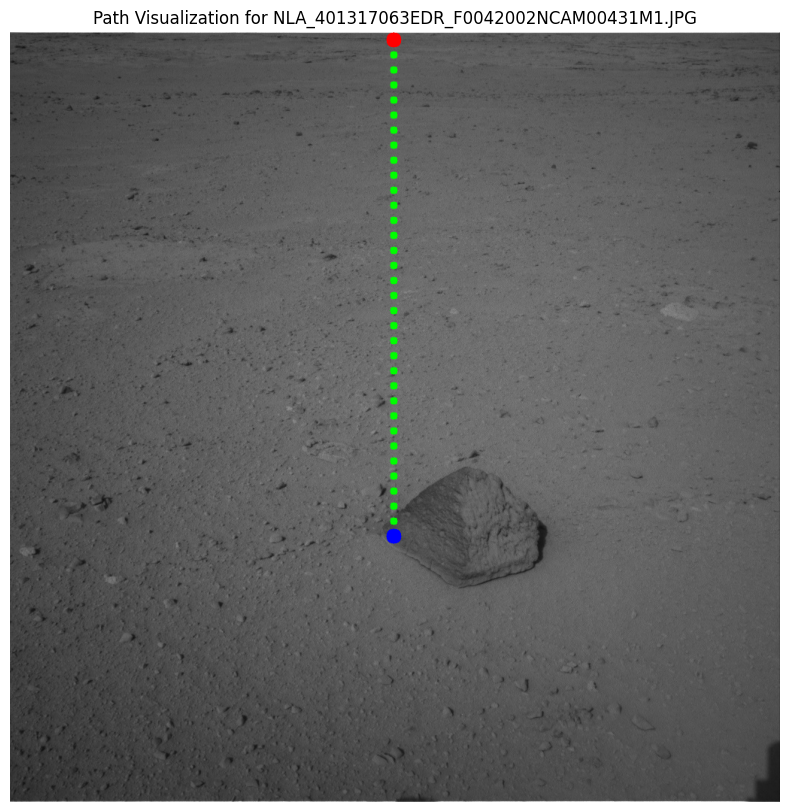

Processing image 31/34: NLA_399627511EDR_F0030372NCAM00407M1.JPG
Path found!


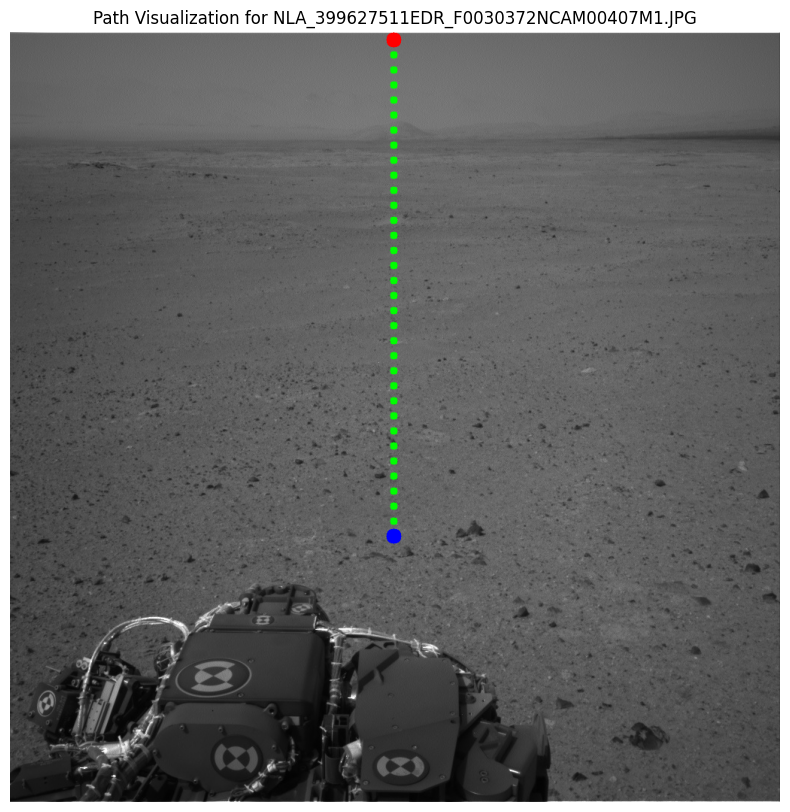

Processing image 32/34: NLA_400070989EDR_F0040000NCAM00408M1.JPG
Path found!


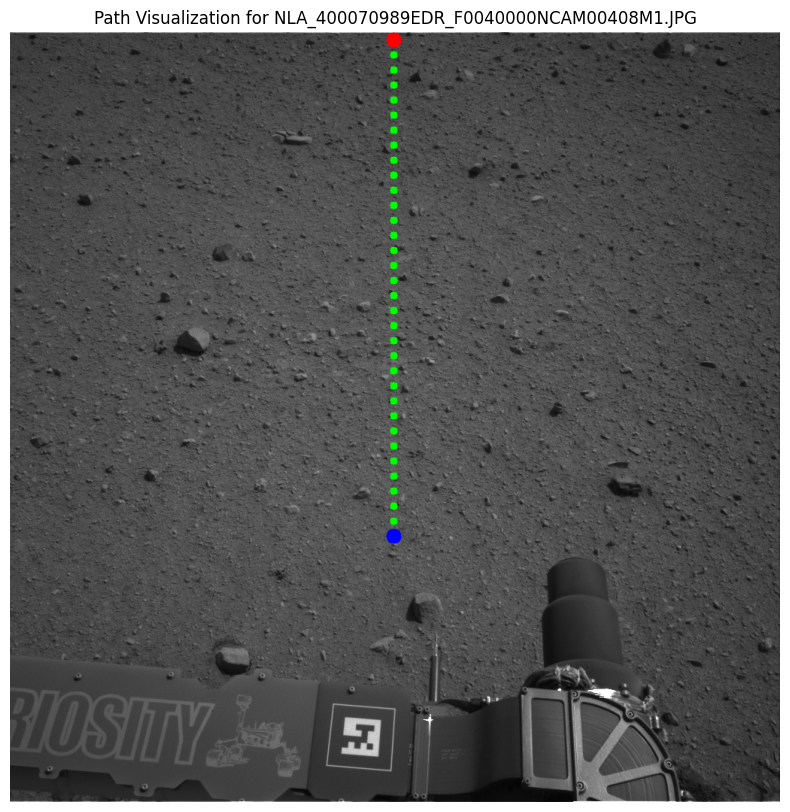

Processing image 33/34: NLA_398919948EDR_F0030078NCAM00303M1.JPG
Path found!


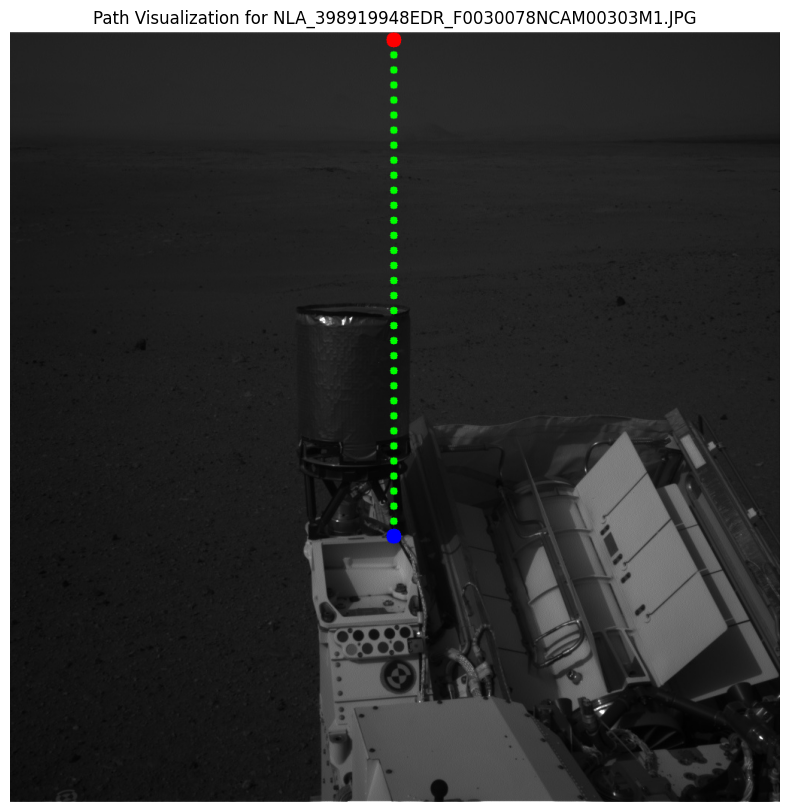

Processing image 34/34: NLA_398919607EDR_F0030078NCAM00300M1.JPG
Path found!


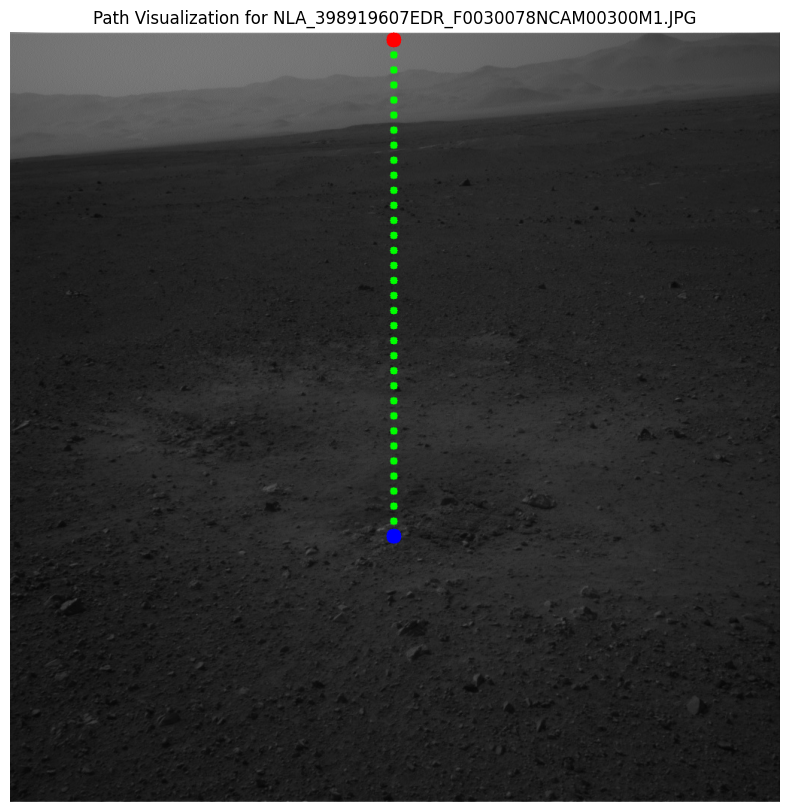

In [ ]:
import os
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import heapq
import matplotlib.pyplot as plt

IMAGE_PATH = "/content/drive/MyDrive/DGMD E-14/Project/MARSDATA"
MODEL_PATH = "mars_obstacle_model.h5"
IMG_HEIGHT, IMG_WIDTH = 128, 128

def load_trained_model(model_path):
    model = load_model(model_path)
    return model

def load_images(image_path):
    images = []
    filenames = []
    original_images = []

    for file in os.listdir(image_path):
        if file.lower().endswith((".jpg", ".png", ".jpeg")):
            img_path = os.path.join(image_path, file)
            img = cv2.imread(img_path)
            if img is not None:
                img_resized = cv2.resize(img, (IMG_HEIGHT, IMG_WIDTH))
                images.append(img_resized)
                original_images.append(img)
                filenames.append(file)
            else:
                print(f"Warning: Failed to load {file}")
    print(f"Loaded {len(images)} images.")
    return np.array(images), filenames, original_images

def detect_large_obstacles(img, grid_size, min_area=500):

    edges = cv2.Canny(img, 50, 150)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    grid = np.zeros(grid_size, dtype=int)
    img_height, img_width = img.shape[:2]
    cell_height, cell_width = img_height // grid_size[0], img_width // grid_size[1]

    # Filter and mark large contours
    for contour in contours:
        area = cv2.contourArea(contour)
        if area > min_area:
            x, y, w, h = cv2.boundingRect(contour)
            start_row, end_row = y // cell_height, (y + h) // cell_height
            start_col, end_col = x // cell_width, (x + w) // cell_width
            for r in range(start_row, min(end_row + 1, grid_size[0])):
                for c in range(start_col, min(end_col + 1, grid_size[1])):
                    grid[r, c] = 1
    return grid

def a_star(grid, start, goal_candidates):
    def heuristic(a, b):
        return abs(a[0] - b[0]) + abs(a[1] - b[1])

    open_list = []
    heapq.heappush(open_list, (0, start))
    came_from = {}
    cost_so_far = {start: 0}
    goal_found = None

    while open_list:
        _, current = heapq.heappop(open_list)

        if current in goal_candidates:
            goal_found = current
            break

        for dx, dy in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
            next_node = (current[0] + dx, current[1] + dy)
            if (
                0 <= next_node[0] < grid.shape[0]
                and 0 <= next_node[1] < grid.shape[1]
                and grid[next_node] == 0
            ):
                new_cost = cost_so_far[current] + 1
                if next_node not in cost_so_far or new_cost < cost_so_far[next_node]:
                    cost_so_far[next_node] = new_cost
                    priority = new_cost + heuristic(goal_candidates[0], next_node)
                    heapq.heappush(open_list, (priority, next_node))
                    came_from[next_node] = current

    path = []
    current = goal_found
    while current != start:
        path.append(current)
        current = came_from.get(current)
        if current is None:
            print("No path found!")
            return [], None
    path.reverse()
    return path, goal_found

def visualize_with_image(original_img, grid, path, start, goal, filename):
    plt.figure(figsize=(10, 10))
    img_copy = original_img.copy()

    rows, cols = grid.shape
    img_height, img_width = original_img.shape[:2]
    cell_height, cell_width = img_height // rows, img_width // cols

    # Draw path
    for r, c in path:
        y, x = r * cell_height + cell_height // 2, c * cell_width + cell_width // 2
        cv2.circle(img_copy, (x, y), 5, (0, 255, 0), -1)  # Green for path

    # Mark start and goal
    start_y, start_x = start[0] * cell_height + cell_height // 2, start[1] * cell_width + cell_width // 2
    goal_y, goal_x = goal[0] * cell_height + cell_height // 2, goal[1] * cell_width + cell_width // 2
    cv2.circle(img_copy, (start_x, start_y), 10, (255, 0, 0), -1)
    cv2.circle(img_copy, (goal_x, goal_y), 10, (0, 0, 255), -1)

    plt.imshow(cv2.cvtColor(img_copy, cv2.COLOR_BGR2RGB))
    plt.title(f"Path Visualization for {filename}")
    plt.axis("off")
    plt.show()

def main():
    model = load_trained_model(MODEL_PATH)

    images, filenames, original_images = load_images(IMAGE_PATH)
    if len(images) == 0:
        print("No images loaded. Exiting...")
        return

    # Process each image
    grid_size = (50, 50)
    for idx, (filename, original_img) in enumerate(zip(filenames, original_images)):
        print(f"Processing image {idx + 1}/{len(filenames)}: {filename}")

        grid = detect_large_obstacles(original_img, grid_size, min_area=500)

        start = (grid_size[0] * 2 // 3, grid_size[1] // 2)
        goal_candidates = [(0, col) for col in range(grid_size[1])]

        path, goal = a_star(grid, start, goal_candidates)
        if path:
            print("Path found!")
            visualize_with_image(original_img, grid, path, start, goal, filename)
        else:
            print("No valid path found.\n")

if __name__ == "__main__":
    main()